In [1]:
import re
import pandas as pd

path = 'arrets_ben.csv'

# 1) Grab the header line + dash line
with open(path, encoding='utf-8') as f:
    header_line = f.readline().rstrip('\n')
    dash_line   = f.readline().rstrip('\n')

# 2) Infer colspecs from runs of dashes
colspecs = [(m.start(), m.end()) for m in re.finditer(r'-+', dash_line)]

# 3) Slice out the raw names from the header
raw_names = [header_line[start:end].strip() for start, end in colspecs]

# 4) De‑duplicate any repeated names by appending a counter
seen = {}
names = []
for nm in raw_names:
    if nm in seen:
        seen[nm] += 1
        names.append(f"{nm}_{seen[nm]}")
    else:
        seen[nm] = 0
        names.append(nm)

# 5) Read the data as fixed‑width, skipping the two top lines
df = pd.read_fwf(
    path,
    colspecs=colspecs,
    names=names,
    skiprows=[0, 1],      # drop both the header and the dash‐line
    na_values=['NULL'],   # turn “NULL” → NaN
    dtype=str             # optional: everything as string if you’ll parse types later
)

print(df.shape)           # expect (n_rows, 73)
print(df.columns.tolist())  
df.head()




Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
(2301409, 73)
['\ufeffIdCourse', 'IdArret', 'RangArretAs', 'DateCours', 'HDepartThe', 'HArriveeThe', 'DistanceThe', 'TempsInterArretThe', 'EcartDepar', 'EcartDistanc', 'TempsPasseArre', 'TempsInterArretRealis', 'VitesseInterArre', 'NbMontees', 'NbDescente', 'Charge', 'FlagArretReferenc', 'FlagDeviatio', 'FlagDelocalisatio', 'FlagRecalag', 'FlagRegulatio', 'IdArretPreceden', 'DistanceInterArre', 'NbMonteesPorte', 'NbDescentesPorte', 'NbMonteesPorte_1', 'NbDescentesPorte_1', 'NbMonteesPorte_2', 'N

,﻿IdCourse,IdArret,RangArretAs,DateCours,HDepartThe,HArriveeThe,DistanceThe,TempsInterArretThe,EcartDepar,EcartDistanc,...,C_Lign,C_NoParcoursApp,C_NumVoitur,C_ParcoursTypeApp,C_SensApp,C_ServiceVoitur,C_TempsBattemen,C_TypeAppl,CodeLong,Arret
0,83748979,261,1,2024-10-01,16:59:00,16:59:00,0,0,58,0,...,18,78,91,55257,R,18-91,125,0,CERN01,CERN
1,83748853,261,1,2024-10-01,06:31:00,06:31:00,0,0,-6,0,...,18,78,87,55257,R,18-87,449,0,CERN01,CERN
2,83748927,6948,1,2024-10-01,05:07:00,05:07:00,0,0,255,0,...,18,6,90,49578,A,18-90,22,2,DE00,DEPOT EN-CHARDON
3,83748978,260,1,2024-10-01,16:46:00,16:46:00,0,0,-82,0,...,18,10,91,50446,R,18-91,0,1,CERN00,CERN
4,83748928,702,1,2024-10-01,05:09:00,05:09:00,0,0,229,0,...,18,4,90,54136,A,18-90,0,0,JALP00,JARDIN-ALPIN-V.


In [5]:
# A better way to read the same file, handling BOM and end-of-line truncation

import re
import pandas as pd
from pathlib import Path

path = "../arrets_ben.csv"
out_parquet = "arrets_ben.parquet"

# --- 1) Read header + dash line, remove BOM automatically ---
with open(path, encoding="utf-8-sig") as f:
    header_line = f.readline().rstrip("\n")
    dash_line   = f.readline().rstrip("\n")

# --- 2) Infer column spans from runs of dashes ---
colspecs = [(m.start(), m.end()) for m in re.finditer(r"-+", dash_line)]

# Make the last column go to end-of-line to avoid truncation
colspecs[-1] = (colspecs[-1][0], None)

# --- 3) Slice column names from the (BOM-stripped) header ---
raw_names = [header_line[s:] if e is None else header_line[s:e] for s, e in colspecs]
names = []
seen = {}
for nm in map(str.strip, raw_names):
    seen[nm] = seen.get(nm, -1) + 1
    names.append(nm if seen[nm] == 0 else f"{nm}_{seen[nm]}")

print("Detected columns:", len(names))
print(names[:10], "...")

# --- 4) Read the data as fixed-width (skip header + dashes) ---
df = pd.read_fwf(
    path,
    colspecs=colspecs,
    names=names,
    skiprows=2,
    na_values=["NULL"],
    encoding="utf-8-sig",
)
print(df.shape)
print(df.head(3))

Detected columns: 73
['IdCourse', 'IdArret', 'RangArretAsc', 'DateCourse', 'HDepartTheo', 'HArriveeTheo', 'DistanceTheo', 'TempsInterArretTheo', 'EcartDepart', 'EcartDistance'] ...
(2301409, 73)
   IdCourse  IdArret  RangArretAsc  DateCourse HDepartTheo HArriveeTheo  \
0  83748979      261             1  2024-10-01    16:59:00     16:59:00   
1  83748853      261             1  2024-10-01    06:31:00     06:31:00   
2  83748927     6948             1  2024-10-01    05:07:00     05:07:00   

   DistanceTheo  TempsInterArretTheo  EcartDepart  EcartDistance  ...  \
0             0                    0           58              0  ...   
1             0                    0           -6              0  ...   
2             0                    0          255              0  ...   

   C_Ligne  C_NoParcoursAppl  C_NumVoiture  C_ParcoursTypeAppl  C_SensAppl  \
0       18              78.0            91             55257.0           R   
1       18              78.0            87             

In [30]:
df.head()

,IdCourse,IdArret,RangArretAsc,DateCourse,HDepartTheo,HArriveeTheo,DistanceTheo,TempsInterArretTheo,EcartDepart,EcartDistance,...,C_Ligne,C_NoParcoursAppl,C_NumVoiture,C_ParcoursTypeAppl,C_SensAppl,C_ServiceVoiture,C_TempsBattement,C_TypeAppl,CodeLong,Arret
0,83748979,261,1,2024-10-01,16:59:00,16:59:00,0,0,58,0,...,18,78.0,91,55257.0,R,18-91,125.0,0.0,CERN01,CERN
1,83748853,261,1,2024-10-01,06:31:00,06:31:00,0,0,-6,0,...,18,78.0,87,55257.0,R,18-87,449.0,0.0,CERN01,CERN
2,83748927,6948,1,2024-10-01,05:07:00,05:07:00,0,0,255,0,...,18,6.0,90,49578.0,A,18-90,22.0,2.0,DE00,DEPOT EN-CHARDON
3,83748978,260,1,2024-10-01,16:46:00,16:46:00,0,0,-82,0,...,18,10.0,91,50446.0,R,18-91,0.0,1.0,CERN00,CERN
4,83748928,702,1,2024-10-01,05:09:00,05:09:00,0,0,229,0,...,18,4.0,90,54136.0,A,18-90,0.0,0.0,JALP00,JARDIN-ALPIN-V.


In [6]:
import pandas as pd
import numpy as np

# -------------------------
# 0) CONFIG
# -------------------------
LINE = 18
DATE_FROM = "2024-10-01"
DATE_TO   = "2025-04-30"

# segments requested (from → to) using MNLP / CodeLong
SEGMENTS = [
    ("BOLA00", "MYRN00"),
    ("MYRN00", "HTOU00"),
    ("HTOU00",  "MAIX00"),
]

# Brand/Ben thresholds (seconds / km/h)
alpha1 = 60    # large dwell
alpha2 = 120   # large dwell variation (p85-p15)
alpha3 = -60   # early departure
alpha4 = 180   # late departure
alpha5 = 300   # large dep. time variation (p85-p15)
alpha6 = 60    # punctuality change wrt previous
alpha7 = 15    # low speed (km/h)
alpha8 = 60    # travel time excess over free flow (s)

# -------------------------
# 1) PREP & CLEAN
# -------------------------
# keep the requested date range & line 18 & commercial trips if available
if "DateCourse" in df.columns:
    df["DateCourse"] = pd.to_datetime(df["DateCourse"], errors="coerce")
    df = df[(df["DateCourse"] >= DATE_FROM) & (df["DateCourse"] <= DATE_TO)]

df = df[df["C_Ligne"] == LINE]
if "C_TypeAppl" in df.columns:
    df = df[df["C_TypeAppl"] == 0]  # commercial only

# parse the datetimes we need
for c in ["DTDepartTheo","DTEntreeFenetreArretReal","DTSortieFenetreArretReal"]:
    if c in df.columns:
        df[c] = pd.to_datetime(df[c], errors="coerce")

# ensure CodeLong is a clean string
df["CodeLong"] = df["CodeLong"].astype(str).str.strip()

# -------------------------
# 2) BUILD SEGMENT ROWS
# Each row i (stop i) represents segment (prev stop -> current stop)
# travel time = entry_time@i - exit_time@(i-1) within the same IdCourse
# -------------------------
df = df.sort_values(["IdCourse", "RangArretAsc"])

df["prev_CodeLong"]  = df.groupby("IdCourse")["CodeLong"].shift(1)
df["prev_exit_time"] = df.groupby("IdCourse")["DTSortieFenetreArretReal"].shift(1)

# keep rows that have a previous stop (i.e., a valid segment)
seg = df.dropna(subset=["prev_CodeLong","DTEntreeFenetreArretReal","prev_exit_time"]).copy()

# segment id like 'XXXXYYYY' (Ben used 8-char codes; we concatenate as-is)
seg["SegmentID"] = (seg["prev_CodeLong"].str[:4] + seg["CodeLong"].str[:4]).str.zfill(8)

# travel time (s), distance (m), speed (km/h)
seg["segment_travel_time"] = (seg["DTEntreeFenetreArretReal"] - seg["prev_exit_time"]).dt.total_seconds()
seg = seg[seg["segment_travel_time"] > 0]  # sanity

# DistanceInterArret may correspond to current link; subtract 70m windows
dist_col = "DistanceInterArret" if "DistanceInterArret" in seg.columns else "DistanceTheo"
seg[dist_col] = pd.to_numeric(seg[dist_col], errors="coerce")
seg = seg[seg[dist_col] > 0]
seg["segment_distance_m"] = seg[dist_col] - 70.0
seg = seg[seg["segment_distance_m"] > 0]

seg["segment_speed_kmh"] = 3.6 * seg["segment_distance_m"] / seg["segment_travel_time"]

# dwell time at current stop (window time)
seg["dwell_time"] = (seg["DTSortieFenetreArretReal"] - seg["DTEntreeFenetreArretReal"]).dt.total_seconds()

# -------------------------
# 3) PERIOD ASSIGNMENT (from theoretical departure time)
# -------------------------
def assign_period(dt):
    if pd.isna(dt): 
        return "Other"
    d = dt.dayofweek  # Mon=0 ... Sun=6
    h = dt.hour
    if d == 5:  # Saturday
        return "Saturdays"
    if d == 6:  # Sunday
        return "Sundays"
    if 7 <= h < 9:
        return "AM peak"
    elif 9 <= h < 16:
        return "Day period"
    elif 16 <= h < 19:
        return "PM peak"
    elif 19 <= h < 23:
        return "Evening"
    else:
        return "Other"

seg["period"] = seg["DTDepartTheo"].map(assign_period)

# -------------------------
# 4) FILTER TO THE 3 REQUESTED SEGMENTS
# (match using full MNLP codes, not 4-char)
# -------------------------
want_ids = [f"{a}{b}" for a,b in SEGMENTS]
seg["SegmentKey"] = seg["prev_CodeLong"].str.strip() + "→" + seg["CodeLong"].str.strip()
seg3 = seg[(seg["prev_CodeLong"].isin([a for a,_ in SEGMENTS])) &
           (seg["CodeLong"].isin([b for _,b in SEGMENTS])) &
           (seg["SegmentKey"].isin([f"{a}→{b}" for a,b in SEGMENTS]))].copy()

# -------------------------
# 5) BEN’S “MEAN SPEED BY PERIOD” TABLE (Excel-ready)
# -------------------------
pivot_speed = (
    seg3
    .assign(Segment_X=seg3["prev_CodeLong"].str[:4] + seg3["CodeLong"].str[:4])
    .pivot_table(index="Segment_X", columns="period", values="segment_speed_kmh", aggfunc="mean")
    .reindex(columns=["AM peak","Day period","PM peak","Evening","Saturdays","Sundays","Other"])
    .round(3)
)
pivot_speed["net"] = seg3.groupby(seg3["prev_CodeLong"].str[:4] + seg3["CodeLong"].str[:4])["segment_speed_kmh"].mean().round(3)
pivot_speed = pivot_speed.reset_index()

pivot_speed.to_csv("line18_segments_mean_speed_by_period.csv", index=False)
print("Wrote: line18_segments_mean_speed_by_period.csv")

# -------------------------
# 6) BEN’S 8 CRITERIA (counts by period) FOR THE 3 SEGMENTS
# -------------------------
# per-period IQR-like spreads
def p85_minus_p15(x):
    x = x.dropna()
    if len(x) < 2: return 0.0
    return np.percentile(x,85) - np.percentile(x,15)

# compute period spreads on the fly for each SegmentID
def add_flags(df_seg):
    # dwells
    df_seg["large_dwell_time"] = df_seg["dwell_time"] > alpha1

    spread_dw = df_seg.groupby("period")["dwell_time"].apply(p85_minus_p15).to_dict()
    df_seg["large_var_in_dwell"] = df_seg["period"].map(lambda p: spread_dw.get(p,0) > alpha2)

    # departures
    if "EcartDepart" in df_seg.columns:
        df_seg["early_departure"] = df_seg["EcartDepart"] < alpha3
        df_seg["late_departure"]  = df_seg["EcartDepart"] > alpha4
        spread_dep = df_seg.groupby("period")["EcartDepart"].apply(p85_minus_p15).to_dict()
        df_seg["large_var_in_departure"] = df_seg["period"].map(lambda p: spread_dep.get(p,0) > alpha5)
        df_seg = df_seg.sort_values("DTDepartTheo")
        df_seg["EcartDepart_prev"] = df_seg["EcartDepart"].shift(1)
        df_seg["punct_change_prev"] = (df_seg["EcartDepart"] - df_seg["EcartDepart_prev"]).abs() > alpha6
    else:
        # if missing, set False
        for c in ["early_departure","late_departure","large_var_in_departure","punct_change_prev"]:
            df_seg[c] = False

    # low speed
    df_seg["low_speed"] = df_seg["segment_speed_kmh"] < alpha7

    # free-flow baseline: 15th percentile of Sunday segment travel time (computed from all rows with same SegmentID)
    base = seg[seg["period"]=="Sundays"].groupby("SegmentID")["segment_travel_time"].quantile(0.15)
    df_seg = df_seg.merge(base.rename("freeflow_15th"), on="SegmentID", how="left")
    df_seg["large_travel_time_vs_freeflow"] = (df_seg["segment_travel_time"] - df_seg["freeflow_15th"]) > alpha8

    criteria = [
        "large_dwell_time","large_var_in_dwell","early_departure","late_departure",
        "large_var_in_departure","punct_change_prev","low_speed","large_travel_time_vs_freeflow"
    ]
    df_seg["any_criterion"] = df_seg[criteria].any(axis=1)

    # summarize counts by period
    out = df_seg.groupby("period")[criteria + ["any_criterion"]].sum().astype(int)
    out["num_trips"] = df_seg.groupby("period").size()
    out = out.reset_index()
    out["Segment_X"] = df_seg["prev_CodeLong"].str[:4].iloc[0] + df_seg["CodeLong"].str[:4].iloc[0]
    return out

# apply per requested segment
summaries = []
for a,b in SEGMENTS:
    sub = seg3[(seg3["prev_CodeLong"]==a) & (seg3["CodeLong"]==b)].copy()
    if not sub.empty:
        s = add_flags(sub)
        summaries.append(s)

if summaries:
    crit_tbl = pd.concat(summaries, ignore_index=True)
    # order columns nicely
    cols = ["Segment_X","period","num_trips",
            "large_dwell_time","large_var_in_dwell","early_departure","late_departure",
            "large_var_in_departure","punct_change_prev","low_speed","large_travel_time_vs_freeflow",
            "any_criterion"]
    crit_tbl = crit_tbl[cols]
    crit_tbl.to_csv("line18_segments_bottleneck_criteria_by_period.csv", index=False)
    print("Wrote: line18_segments_bottleneck_criteria_by_period.csv")
else:
    print("No rows found for the requested segments. Check CodeLong spellings.")

Wrote: line18_segments_mean_speed_by_period.csv
Wrote: line18_segments_bottleneck_criteria_by_period.csv


In [7]:
# ========= CONFIG =========
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path

# 線別：None=全線；或例如 [18] / [18,80]
LINES = None
SAMPLE_MONTH_START = "2024-10-01"
SAMPLE_MONTH_END   = "2024-10-31"  # 含當日
TOPN_FOR_HEATMAP = 40              # 熱圖顯示的段數上限（依 trips 排序）

outdir = Path("eda_oct")
outdir.mkdir(exist_ok=True)

# ========= 1) 篩 10 月樣本 + (選擇性)線別 =========
if "DateCourse" in df.columns:
    df["DateCourse"] = pd.to_datetime(df["DateCourse"], errors="coerce")
    df_oct = df[(df["DateCourse"] >= SAMPLE_MONTH_START) & (df["DateCourse"] <= SAMPLE_MONTH_END)].copy()
else:
    # 若沒有 DateCourse，可用實際/理論時間任一欄位的月份判斷
    for c in ["DTDepartTheo","DTEntreeFenetreArretReal","DTSortieFenetreArretReal"]:
        if c in df.columns:
            df[c] = pd.to_datetime(df[c], errors="coerce")
    base = "DTDepartTheo" if "DTDepartTheo" in df.columns else "DTEntreeFenetreArretReal"
    df_oct = df[(df[base] >= SAMPLE_MONTH_START) & (df[base] <= SAMPLE_MONTH_END)].copy()

if LINES is not None and "C_Ligne" in df_oct.columns:
    df_oct = df_oct[df_oct["C_Ligne"].isin(LINES)]

# ========= 2) 建段資料：上一站 -> 本站 =========
df_oct = df_oct.sort_values(["IdCourse", "RangArretAsc"])
for c in ["DTDepartTheo","DTEntreeFenetreArretReal","DTSortieFenetreArretReal"]:
    if c in df_oct.columns:
        df_oct[c] = pd.to_datetime(df_oct[c], errors="coerce")

df_oct["prev_CodeLong"]  = df_oct.groupby("IdCourse")["CodeLong"].shift(1)
df_oct["prev_exit_time"] = df_oct.groupby("IdCourse")["DTSortieFenetreArretReal"].shift(1)

seg = df_oct.dropna(subset=["prev_CodeLong","DTEntreeFenetreArretReal","prev_exit_time"]).copy()

# 行時（秒）、距離（m，扣 70m 窗框）、速度（km/h）
seg["segment_travel_time"] = (seg["DTEntreeFenetreArretReal"] - seg["prev_exit_time"]).dt.total_seconds()
seg = seg[seg["segment_travel_time"] > 0]

dist_col = "DistanceInterArret" if "DistanceInterArret" in seg.columns else ("DistanceTheo" if "DistanceTheo" in seg.columns else None)
if dist_col is None:
    raise ValueError("找不到 DistanceInterArret / DistanceTheo 任何一欄，無法計算速度。")
seg[dist_col] = pd.to_numeric(seg[dist_col], errors="coerce")
seg = seg[seg[dist_col] > 0]
seg["segment_distance_m"] = seg[dist_col] - 70.0
seg = seg[seg["segment_distance_m"] > 0]
seg["segment_speed_kmh"] = 3.6 * seg["segment_distance_m"] / seg["segment_travel_time"]

# 停站時間（秒）
seg["dwell_time"] = (seg["DTSortieFenetreArretReal"] - seg["DTEntreeFenetreArretReal"]).dt.total_seconds()

# 段鍵值（完整 MNLP，便於唯一識別）
seg["SegmentKey"] = seg["prev_CodeLong"].str.strip() + "→" + seg["CodeLong"].str.strip()

# 時段分群（沿用你前面函式）
def assign_period(dt):
    if pd.isna(dt): 
        return "Other"
    d = dt.dayofweek
    h = dt.hour
    if d == 5:  # Sat
        return "Saturdays"
    if d == 6:  # Sun
        return "Sundays"
    if 7 <= h < 9:
        return "AM peak"
    elif 9 <= h < 16:
        return "Day period"
    elif 16 <= h < 19:
        return "PM peak"
    elif 19 <= h < 23:
        return "Evening"
    else:
        return "Other"
seg["period"] = seg["DTDepartTheo"].map(assign_period)

In [12]:
def _mode(x):
    x = x.dropna()
    return x.mode().iloc[0] if len(x) else np.nan

summary = (
    seg.groupby("SegmentKey")
      .agg(
        trips=("SegmentKey","size"),
        mean_speed_kmh=("segment_speed_kmh","mean"),
        p50_runtime_s=("segment_travel_time", lambda x: np.percentile(x.dropna(),50)),
        p85_runtime_s=("segment_travel_time", lambda x: np.percentile(x.dropna(),85)),
        mean_dwell_s=("dwell_time","mean"),
        p85_dwell_s=("dwell_time", lambda x: np.percentile(x.dropna(),85)),
        mean_delay_s=("EcartDepart","mean"),
        line=("C_Ligne", _mode),
        direction=("C_SensAppl", _mode),
        from_stop=("prev_CodeLong", _mode),
        to_stop=("CodeLong", _mode)
      )
      .reset_index()
)

summary = summary.sort_values(["trips","mean_speed_kmh"], ascending=[False, True])

/var/folders/p6/pb4fxjzn3r3b73xfyn72rzr00000gn/T/ipykernel_93262/2968225798.py:6: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(data_by_period, labels=period_order, showfliers=False)


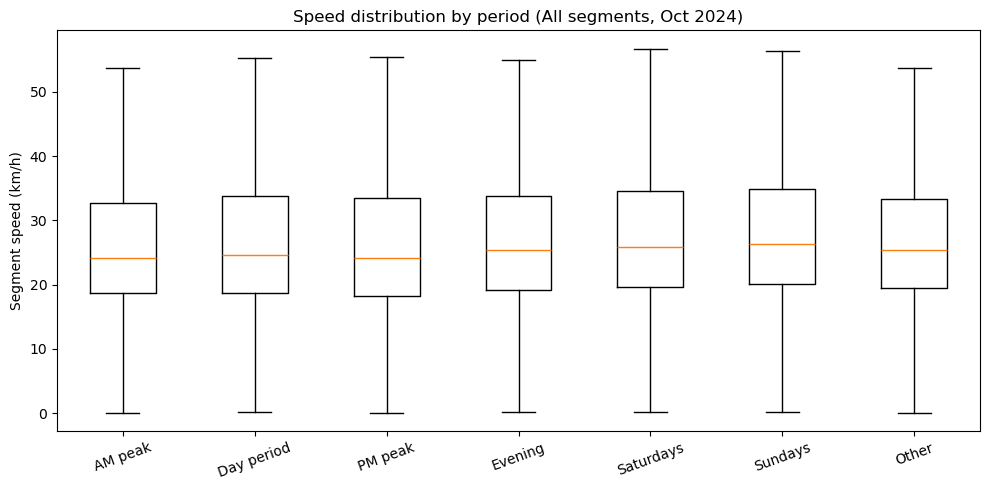

In [13]:
period_order = ["AM peak","Day period","PM peak","Evening","Saturdays","Sundays","Other"]

# 4-1) 速度箱型圖（全部段 × period）
plt.figure(figsize=(10,5))
data_by_period = [seg.loc[seg["period"]==p, "segment_speed_kmh"].dropna().values for p in period_order]
plt.boxplot(data_by_period, labels=period_order, showfliers=False)
plt.ylabel("Segment speed (km/h)")
plt.title("Speed distribution by period (All segments, Oct 2024)")
plt.xticks(rotation=20)
plt.tight_layout()

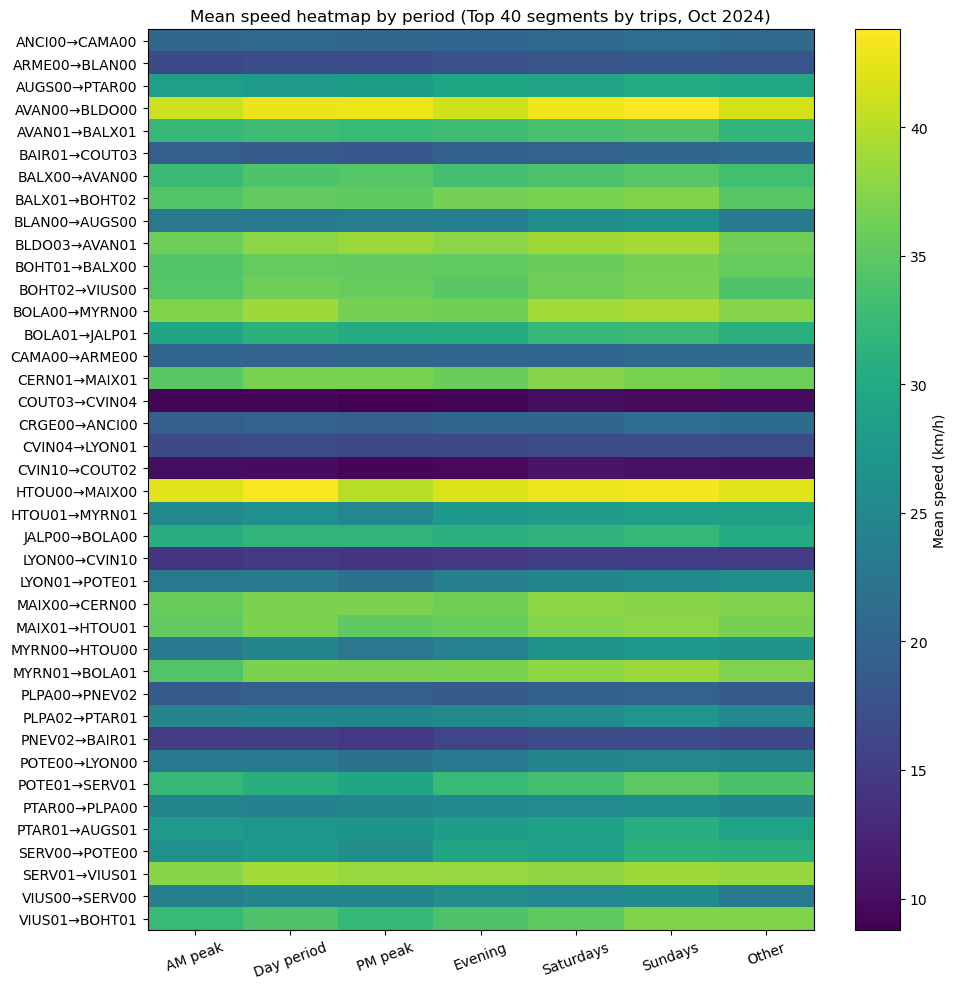

In [15]:
topN_keys = summary.head(TOPN_FOR_HEATMAP)["SegmentKey"].tolist()
heat = (seg[seg["SegmentKey"].isin(topN_keys)]
        .pivot_table(index="SegmentKey", columns="period", values="segment_speed_kmh", aggfunc="mean"))
heat = heat.reindex(columns=period_order)
plt.figure(figsize=(10, max(4, 0.25*len(heat))))
plt.imshow(heat.values, aspect="auto")
plt.colorbar(label="Mean speed (km/h)")
plt.yticks(range(len(heat.index)), heat.index)
plt.xticks(range(len(heat.columns)), heat.columns, rotation=20)
plt.title(f"Mean speed heatmap by period (Top {len(heat)} segments by trips, Oct 2024)")
plt.tight_layout()

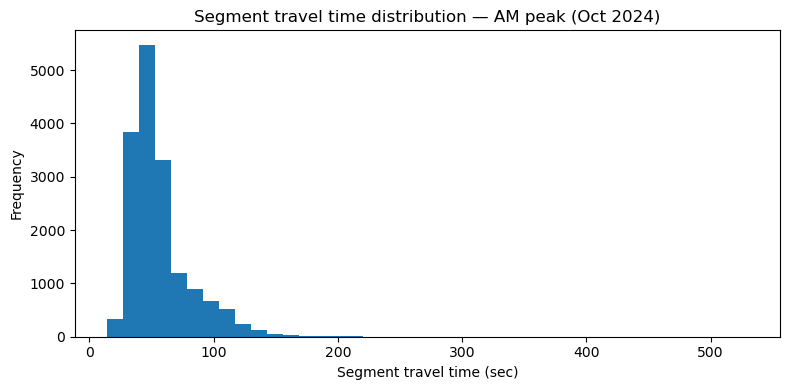

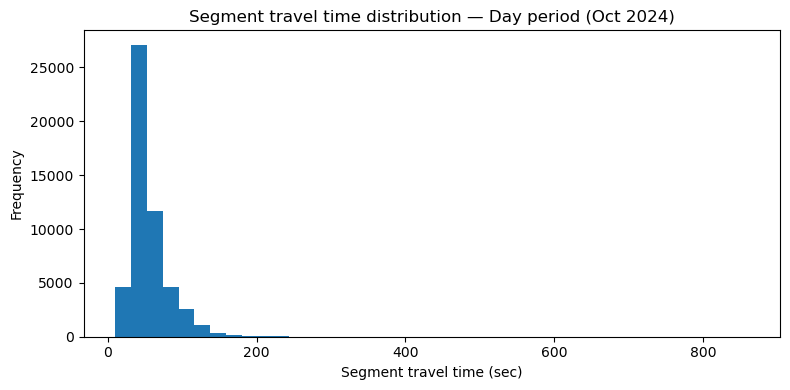

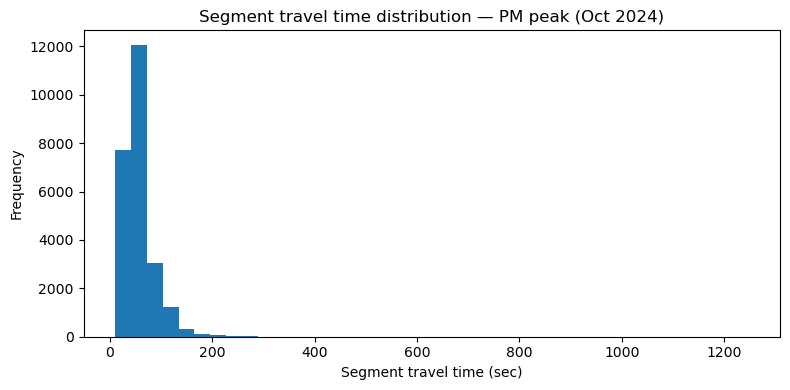

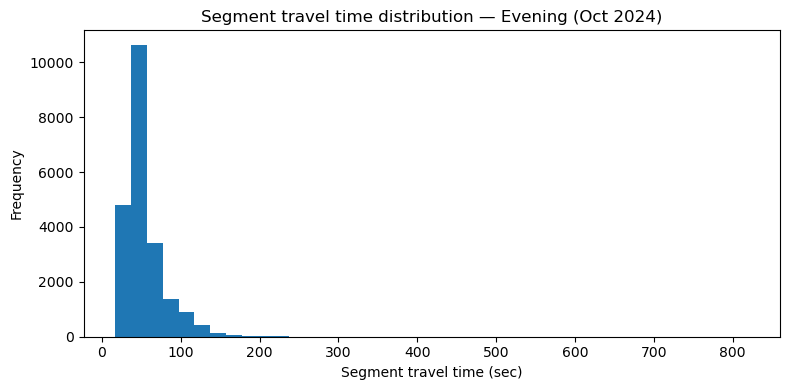

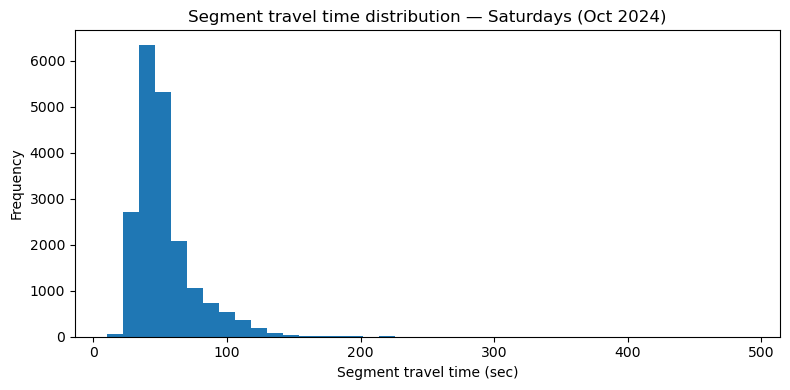

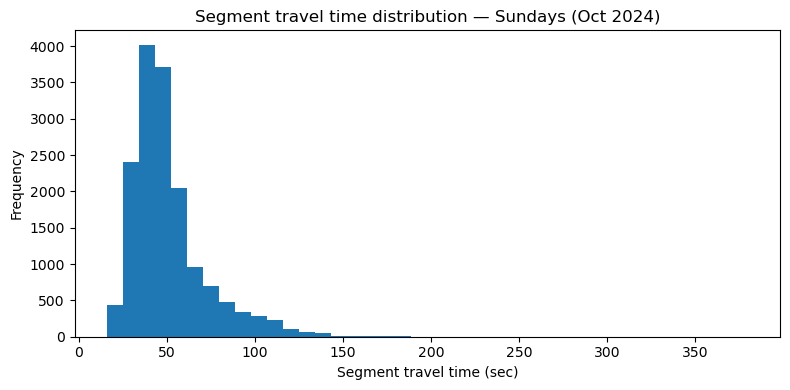

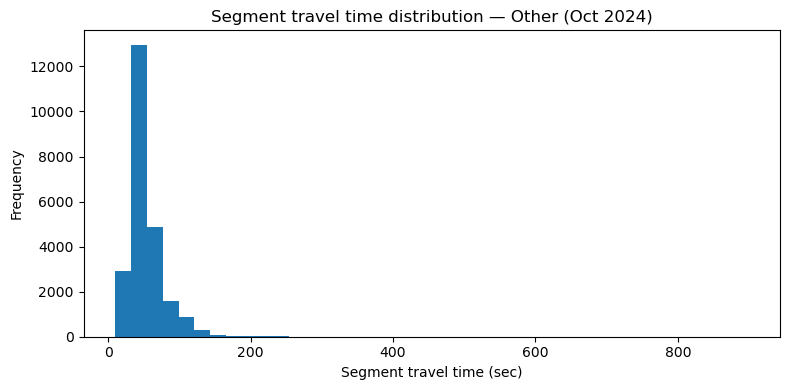

In [16]:
for p in period_order:
    s = seg.loc[seg["period"]==p, "segment_travel_time"].dropna()
    if len(s) < 10: 
        continue
    plt.figure(figsize=(8,4))
    plt.hist(s, bins=40)
    plt.xlabel("Segment travel time (sec)")
    plt.ylabel("Frequency")
    plt.title(f"Segment travel time distribution — {p} (Oct 2024)")
    plt.tight_layout()

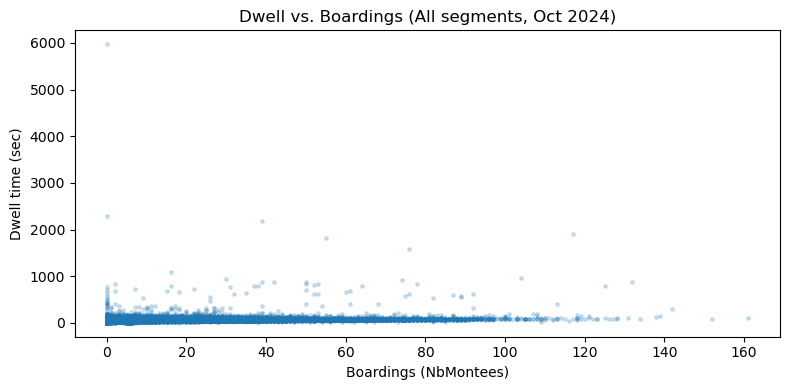

In [17]:
if "NbMontees" in seg.columns:
    x = pd.to_numeric(seg["NbMontees"], errors="coerce")
    y = seg["dwell_time"]
    ok = x.notna() & y.notna()
    if ok.sum() > 50:
        plt.figure(figsize=(8,4))
        plt.scatter(x[ok], y[ok], s=6, alpha=0.2)
        plt.xlabel("Boardings (NbMontees)")
        plt.ylabel("Dwell time (sec)")
        plt.title("Dwell vs. Boardings (All segments, Oct 2024)")
        plt.tight_layout()

In [20]:
import pandas as pd
import geopandas as gpd
import folium

# --- 讀檔 ---
stops = pd.read_csv("../stops_df.csv")  # 內含欄位：MNLP, LIBP, X, Y, ...
lines = gpd.read_file("../TPG_LIGNES-SHP/TPG_LIGNES.shp")

# --- 設定/對齊 CRS ---
# stops：你提供的數值像 497k / 127k → LV03 (EPSG:21781)
gstops = gpd.GeoDataFrame(
    stops,
    geometry=gpd.points_from_xy(stops["X"], stops["Y"]),
    crs="EPSG:21781"
)

# lines：通常是 LV95 (EPSG:2056)；若缺，手動指定
if lines.crs is None:
    lines = lines.set_crs("EPSG:2056")
else:
    lines = lines.to_crs("EPSG:2056")

# 將 stops 轉成與 lines 相同的 2056
gstops = gstops.to_crs(lines.crs)

# --- 給 Folium 用的 WGS84 ---
lines_wgs = lines.to_crs(4326)
stops_wgs = gstops.to_crs(4326)

# --- 建地圖 ---
minx, miny, maxx, maxy = lines_wgs.total_bounds
center = [(miny+maxy)/2, (minx+maxx)/2]
m = folium.Map(location=center, zoom_start=12, tiles="cartodbpositron", control_scale=True)

# 畫路線（每條線一種顏色）
palette = [
    "#1f77b4","#ff7f0e","#2ca02c","#d62728","#9467bd",
    "#8c564b","#e377c2","#7f7f7f","#bcbd22","#17becf"
]
uniq_lines = sorted(lines_wgs["LIGNE"].astype(str).unique())
color_map = {ln: palette[i % len(palette)] for i, ln in enumerate(uniq_lines)}
fg_lines = folium.FeatureGroup(name="Lines", show=True)

for _, row in lines_wgs.explode(index_parts=False).iterrows():
    ln = str(row.get("LIGNE",""))
    nm = row.get("NOM_LIGNE","")
    dr = row.get("DIRECTION", row.get("SENS",""))
    folium.GeoJson(
        row.geometry,
        style_function=lambda x, ln=ln: {"color": color_map.get(ln, "#444"), "weight": 4, "opacity": 0.9},
        tooltip=f"Ligne {ln} — {nm} ({dr})"
    ).add_to(fg_lines)
fg_lines.add_to(m)

# 畫站點（亮色）
fg_stops = folium.FeatureGroup(name="Stops", show=True)
for _, r in stops_wgs.iterrows():
    lat, lon = r.geometry.y, r.geometry.x
    code = str(r.get("MNLP",""))
    name = str(r.get("LIBP",""))
    folium.CircleMarker(
        location=(lat, lon),
        radius=3, weight=1, fill=True, fill_opacity=0.9,
        color="#222", fill_color="#ffff66",
        tooltip=f"{name} ({code})"
    ).add_to(fg_stops)
fg_stops.add_to(m)

folium.LayerControl(collapsed=False).add_to(m)
m

In [22]:
# ==== 需要的套件 ====
import pandas as pd, numpy as np
import geopandas as gpd
from shapely.geometry import LineString
import folium, branca
from pathlib import Path

# ==== 參數 ====
S_MONTH_START = "2024-10-01"
S_MONTH_END   = "2024-10-31"
ALPHA8 = 60.0  # free-flow 超時門檻（秒）
TOPN_SEG = 400 # 為了地圖效能，段間圖層最多顯示多少段（按十月樣本的通過次數排序）

# ==== 1) 讀取線路 & 站點，處理 CRS ====
lines = gpd.read_file("../TPG_LIGNES-SHP/TPG_LIGNES.shp")
if lines.crs is None: lines = lines.set_crs(2056)
else: lines = lines.to_crs(2056)

stops_df = pd.read_csv("../stops_df.csv")  # 有 MNLP, LIBP, X, Y
gstops = gpd.GeoDataFrame(
    stops_df,
    geometry=gpd.points_from_xy(stops_df["X"], stops_df["Y"]),
    crs="EPSG:21781"                     # 你說 X≈497k, Y≈127k → LV03
).to_crs(2056)

# 給 Folium 用
lines_wgs = lines.to_crs(4326)
stops_wgs = gstops.to_crs(4326)

# ==== 2) 篩十月樣本、建立段間資料 ====
for c in ["DTDepartTheo","DTEntreeFenetreArretReal","DTSortieFenetreArretReal"]:
    if c in df.columns:
        df[c] = pd.to_datetime(df[c], errors="coerce")

# 十月樣本（用 DTDepartTheo 或 DateCourse）
if "DateCourse" in df.columns:
    df["DateCourse"] = pd.to_datetime(df["DateCourse"], errors="coerce")
    dfo = df[(df["DateCourse"]>=S_MONTH_START) & (df["DateCourse"]<=S_MONTH_END)].copy()
else:
    base_time = "DTDepartTheo" if "DTDepartTheo" in df.columns else "DTEntreeFenetreArretReal"
    dfo = df[(df[base_time]>=S_MONTH_START) & (df[base_time]<=S_MONTH_END)].copy()

# 排序、生成上一站欄
dfo = dfo.sort_values(["IdCourse","RangArretAsc"])
dfo["prev_CodeLong"]  = dfo.groupby("IdCourse")["CodeLong"].shift(1)
dfo["prev_exit_time"] = dfo.groupby("IdCourse")["DTSortieFenetreArretReal"].shift(1)

seg = dfo.dropna(subset=["prev_CodeLong","DTEntreeFenetreArretReal","prev_exit_time"]).copy()

# 行時（秒）、距離（扣70m窗框）、速度（km/h）
seg["segment_travel_time"] = (seg["DTEntreeFenetreArretReal"] - seg["prev_exit_time"]).dt.total_seconds()
seg = seg[seg["segment_travel_time"] > 0]

dist_col = "DistanceInterArret" if "DistanceInterArret" in seg.columns else "DistanceTheo"
seg[dist_col] = pd.to_numeric(seg[dist_col], errors="coerce")
seg = seg[seg[dist_col] > 0]
seg["segment_distance_m"] = seg[dist_col] - 70.0
seg = seg[seg["segment_distance_m"] > 0]
seg["segment_speed_kmh"] = 3.6 * seg["segment_distance_m"] / seg["segment_travel_time"]

# 停站時間
seg["dwell_time"] = (seg["DTSortieFenetreArretReal"] - seg["DTEntreeFenetreArretReal"]).dt.total_seconds()

# 段鍵
seg["SegmentKey"] = seg["prev_CodeLong"].str.strip() + "→" + seg["CodeLong"].str.strip()

# ===== 3) 段間彙總（十月） =====
def pct(x, q): 
    x = pd.to_numeric(x, errors="coerce").dropna()
    return np.percentile(x, q) if len(x) else np.nan

# Free-flow (周日 p15) 需用全資料或至少十月內的 Sunday 行時
seg["weekday"] = seg["DTDepartTheo"].dt.dayofweek
sunday_ff = (seg[seg["weekday"]==6]
             .groupby("SegmentKey")["segment_travel_time"]
             .quantile(0.15)
             .rename("freeflow_15th"))

# 十月段間聚合
g = seg.groupby("SegmentKey")
seg_summary = pd.DataFrame({
    "trips"            : g.size(),
    "mean_speed_kmh"   : g["segment_speed_kmh"].mean(),
    "p50_runtime_s"    : g["segment_travel_time"].apply(lambda x: pct(x,50)),
    "p85_runtime_s"    : g["segment_travel_time"].apply(lambda x: pct(x,85)),
    "var_runtime_s"    : g["segment_travel_time"].apply(lambda x: pct(x,85)-pct(x,15)),
    "mean_dwell_s"     : g["dwell_time"].mean(),
    "p85_dwell_s"      : g["dwell_time"].apply(lambda x: pct(x,85)),
    "mean_delay_s"     : g["EcartDepart"].mean(),
    "from_stop"        : g["prev_CodeLong"].agg(lambda x: x.mode().iloc[0] if len(x.mode()) else np.nan),
    "to_stop"          : g["CodeLong"].agg(lambda x: x.mode().iloc[0] if len(x.mode()) else np.nan),
})
seg_summary = seg_summary.join(sunday_ff, how="left")
# 超時率（若沒有 freeflow_15th 就是 NaN）
tmp = seg.merge(sunday_ff, left_on="SegmentKey", right_index=True, how="left")
seg_over = (tmp.assign(over=lambda r: (r["segment_travel_time"] - r["freeflow_15th"]) > ALPHA8)
               .groupby("SegmentKey")["over"].mean().rename("excess_vs_ff_rate"))
seg_summary = seg_summary.join(seg_over, how="left")

# 節流：只取樣本最多的 TOPN 段做地圖（避免幾千段拖慢）
top_keys = seg_summary.sort_values("trips", ascending=False).head(TOPN_SEG).index

# ===== 4) 給段間做幾何（連線：上游站 → 下游站） =====
# 建 MNLP → 點的對照
stop_geom_2056 = dict(zip(gstops["MNLP"].astype(str).str.strip(), gstops.geometry))
def make_line(row):
    a = stop_geom_2056.get(str(row["from_stop"]).strip())
    b = stop_geom_2056.get(str(row["to_stop"]).strip())
    if a is not None and b is not None:
        return LineString([a, b])
    return None

seg_geo = seg_summary.loc[top_keys].copy()
seg_geo["geometry"] = seg_geo.apply(make_line, axis=1)
seg_geo = seg_geo.dropna(subset=["geometry"])
seg_gdf = gpd.GeoDataFrame(seg_geo, geometry="geometry", crs=2056).to_crs(4326)

# ===== 5) 站點彙總（十月） =====
stop_sum = (seg.groupby("CodeLong")
              .agg(
                  trips=("CodeLong","size"),
                  mean_dwell_s=("dwell_time","mean"),
                  p85_dwell_s=("dwell_time", lambda x: pct(x,85)),
                  boardings=("NbMontees","sum"),
                  alightings=("NbDescentes","sum")
              )
              .reset_index()
           )
stops_join = stops_wgs.merge(stop_sum, left_on="MNLP", right_on="CodeLong", how="left")

# ===== 6) 畫 Folium 地圖（多圖層） =====
minx, miny, maxx, maxy = lines_wgs.total_bounds
center = [(miny+maxy)/2, (minx+maxx)/2]
m = folium.Map(location=center, zoom_start=12, tiles="cartodbpositron", control_scale=True)

# 底圖：線路
fg_lines = folium.FeatureGroup(name="Lines", show=True)
for _, row in lines_wgs.explode(index_parts=False).iterrows():
    folium.GeoJson(row.geometry, style_function=lambda x: {"color":"#666","weight":2,"opacity":0.7}).add_to(fg_lines)
fg_lines.add_to(m)

def add_segment_layer(val_col, name, cmap=branca.colormap.linear.YlOrRd_09, legend_label=None):
    fg = folium.FeatureGroup(name=name, show=False)
    vals = seg_gdf[val_col].replace([np.inf,-np.inf], np.nan).dropna()
    if vals.empty: 
        return None
    vmin, vmax = float(np.nanquantile(vals, 0.05)), float(np.nanquantile(vals, 0.95))
    cm = cmap.scale(vmin, vmax)
    cm.caption = legend_label or name
    for _, r in seg_gdf.iterrows():
        v = r[val_col]
        if pd.isna(v): 
            continue
        color = cm(v)
        folium.GeoJson(
            r.geometry,
            style_function=lambda x, c=color: {"color": c, "weight": 5, "opacity": 0.9},
            tooltip=(f"{r['from_stop']}→{r['to_stop']}<br>"
                     f"{name}: {v:.2f}"),
        ).add_to(fg)
    fg.add_to(m); cm.add_to(m)
    return fg

# 段間圖層（四個關鍵指標）
add_segment_layer("mean_speed_kmh", "Segments — Mean speed (km/h)")
add_segment_layer("var_runtime_s", "Segments — Variability p85−p15 (s)")
add_segment_layer("p85_runtime_s", "Segments — Runtime p85 (s)")
add_segment_layer("excess_vs_ff_rate", "Segments — Excess vs free-flow rate")

# 站點：以 boardings 畫大小、以 mean_dwell_s 著色
fg_stops = folium.FeatureGroup(name="Stops — dwell & boardings", show=False)
x = stops_join["boardings"].fillna(0.0)
if x.max() > 0:
    # 色帶依 mean_dwell_s
    vals = stops_join["mean_dwell_s"].replace([np.inf,-np.inf], np.nan).dropna()
    if len(vals):
        vmin, vmax = float(np.nanquantile(vals,0.05)), float(np.nanquantile(vals,0.95))
    else:
        vmin, vmax = 0, 60
    cm_dwell = branca.colormap.linear.PuBu_09.scale(vmin, vmax); cm_dwell.caption = "Mean dwell (s)"
    for _, r in stops_join.iterrows():
        lat, lon = r.geometry.y, r.geometry.x
        dw = r.get("mean_dwell_s", np.nan)
        size = 3 + 7 * (r.get("boardings", 0.0) / (x.max() if x.max()>0 else 1.0))  # 半徑 3–10
        color = cm_dwell(dw if pd.notna(dw) else vmin)
        folium.CircleMarker(
            location=(lat, lon), radius=float(size),
            color="#111", weight=0.5, fill=True, fill_opacity=0.9, fill_color=color,
            tooltip=(f"{r.get('LIBP','')} ({r.get('MNLP','')})<br>"
                     f"boardings={r.get('boardings',0):.0f}, alightings={r.get('alightings',0):.0f}<br>"
                     f"mean dwell={r.get('mean_dwell_s',np.nan):.1f}s, p85 dwell={r.get('p85_dwell_s',np.nan):.1f}s")
        ).add_to(fg_stops)
    fg_stops.add_to(m); cm_dwell.add_to(m)

folium.LayerControl(collapsed=False).add_to(m)
m.save("tpg_oct_map.html")
print("Map saved to tpg_oct_map.html")
m

Map saved to tpg_oct_map.html
